<a href="https://colab.research.google.com/github/yeesem/Advanced-Tensorflow-Specialization/blob/main/GradCAM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [1]:
import warnings
warnings.filterwarnings('ignore')

import os
import glob
import cv2
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from skimage.io import imread,imsave
from skimage.transform import resize
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras.applications import vgg16
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import SGD,Adam,RMSprop

import tensorflow as tf
import tensorflow.keras.backend as K
import tensorflow_datasets as tfds
import tensorflow_hub as hub

import imgaug as ia
from imgaug import augmenters as iaa

# Download and Prepare the Dataset

In [ ]:
tfds.disable_progress_bar()

splits = ['train[:80%]','train[80%:90%]','train[90%:]']

# Load the dataset given the splits defined above
# as_supervised is set to True -  the dataset is loaded in a format where each example consists of a tuple (input, label)
splits,info = tfds.load('cats_vs_dogs',with_info = True,as_supervised = True,split = splits)

(train_examples,validation_examples,test_examples) = splits

num_examples = info.splits['train'].num_examples
num_classes = info.features['label'].num_classes

Dataset cats_vs_dogs downloaded and prepared to /root/tensorflow_datasets/cats_vs_dogs/4.0.1. Subsequent calls will reuse this data.


In [ ]:
BATCH_SIZE = 32
IMAGE_SIZE = (224,224)

# resizes the image and normalized the pixel values
def format_image(image,label):
  imag = tf.image.resize(image,IMAGE_SIZE) / 255.0
  return imag,label

# Prepare batches
# prefetch - is used as part of the data pipeline to improve the efficiency of data loading.
# autotune - tells TensorFlow to automatically tune the prefetch buffer size
train_batches = train_examples.shuffle(num_examples // 4).map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
validation_batches = validation_examples.map(format_image).batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)
test_batches = test_examples.map(format_image).batch(1)

# Modelling

In [ ]:
def build_model():
  # Load the base VGG model
  base_model = vgg16.VGG16(
      input_shape = IMAGE_SIZE + (3,),
      weights = 'imagenet',
      include_top = False
  )

  # Add a GAP layer
  output = layers.GlobalAveragePooling2D()(base_model.output)

  # Output has two neurons for the 2 classes
  output = layers.Dense(2,activation = 'softmax')(output)

  # Set the inputs and outputs of the model
  model = Model(base_model.input,output)

  # Freeze the earlier layers
  for layer in base_model.layers[:-4]:
    layer.trainable = False

  # choose the optimizer
  optimizer = tf.keras.optimizers.RMSprop(0.001)

  # Configure the model for training
  model.compile(
      loss = 'sparse_categorical_crossentropy',
      optimizer = optimizer,
      metrics = ['accuracy']
  )

  model.summary()

  return model

In [ ]:
model = build_model()

58889256/58889256 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

In [ ]:
EPOCHS = 3

model.fit(
    train_batches,
    epochs = EPOCHS,
    validation_data = validation_batches
)

Epoch 1/3
582/582 [==============================] - 133s 193ms/step - loss: 0.7503 - accuracy: 0.7945 - val_loss: 0.2218 - val_accuracy: 0.9149
Epoch 2/3
582/582 [==============================] - 113s 180ms/step - loss: 0.1473 - accuracy: 0.9448 - val_loss: 0.1855 - val_accuracy: 0.9175
Epoch 3/3
582/582 [==============================] - 110s 180ms/step - loss: 0.1052 - accuracy: 0.9628 - val_loss: 0.2152 - val_accuracy: 0.9428


# Model Interpretability

In [ ]:
# Select all the layers for which you want to visualize the outputs and store it in a list
outputs = [layer.output for layer in model.layers[1:18]]

# Define a new model that generates the above output
vis_model = Model(model.input,outputs)

# Store the layer names we are interested in
layer_names = []
for layer in outputs:
  layer_names.append(layer.name.split("/")[0])

print("Layers that will be used for visualization : ")
print(layer_names)

Layers that will be used for visualization : 
['block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3']


# Class activation maps (GradCAM)

In [ ]:
def get_CAM(preprocessed_image,actual_label,layer_name = 'block5_conv3'):
  model_grad = Model(
      [model.inputs],
      [model.get_layer(layer_name).output,model.output]
  )

  with tf.GradientTape() as tape:
    conv_output_values,predictions = model_grad(preprocessed_image)

    # watch the conv_output_values
    tape.watch(conv_output_values)

    # Use binary cross entropy loss
    # actual label is 0 if cat, 1 is dog
    # get prediction probability of dog
    # If model does well
    # pred_prob should be close to 0 if cat,close to 1 if dog
    pred_prob = predictions[:,1]

    # Make sure actual label is a float, like the rest of the loss calculation
    actual_label = tf.cast(actual_label,dtype = tf.float32)

    # Add a tiny value to avoid log of 0
    smoothing = 0.00001

    # Calculate loss as binary cross entropy
    loss = -1 * (actual_label * tf.math.log(pred_prob + smoothing) + (1 - actual_label) * tf.math.log(1 - pred_prob + smoothing))
    print(f"binary loss: {loss}")

  # get the gradient of the loss with respect to the outputs of the last conv layer
  grad_values = tape.gradient(loss,conv_output_values)
  grad_values = K.mean(grad_values,axis = (0,1,2))

  conv_output_values = np.squeeze(conv_output_values.numpy())
  grads_values = grad_values.numpy()

  # weight the convolutional outputs with the computed gradients
  # Each feature map in the last convolutional layer is modified based on the computed gradients.
  # This is done by adding the gradient values to the corresponding feature map.
  # This process is intended to highlight regions in the feature maps that contributed the most to the final prediction.
  for i in range(512):
    conv_output_values[:,:,i] += grads_values[i]

  # Exp - 3D tensor with shape (14, 14, 512)
  # After mean(axis = -1) - shape (14, 14)
  heatmap = np.mean(conv_output_values,axis = -1)
  # It is a relu activation function
  # Negative values in heatmap can be less meaningful for visualizing areas of interest in the image
  heatmap = np.maximum(heatmap,0)
  # Normalize the heatmap to range [0,1]
  heatmap /= heatmap.max()

  del model_grad,conv_output_values,grads_values,loss

  return heatmap

In [ ]:
def show_sample(idx = None):
  if idx:
    for img,label in test_batches.take(idx):
      sample_image = img[0]
      sample_label = label[0]

  else:
    for img,label in test_batches.shuffle(1000).take(1):
      sample_image = img[0]
      sample_label = label[0]

  # Expands the dimensions of sample_image to match the expected input shape of the model (batch size of 1)
  sample_image_processed = np.expand_dims(sample_image,axis = 0)

  # Uses vis_model to get intermediate activations for the processed sample image.
  activations = vis_model.predict(sample_image_processed)

  # model to predict the label for the sample image and finds the predicted label using np.argmax.
  pred_label = np.argmax(model.predict(sample_image_processed),axis = -1)[0]

  # Extracts the 17th feature map (index 16) from the first activation.
  sample_activation = activations[0][0,:,:,16]

  # Normalizes the feature map: subtracts the mean, divides by the standard deviation, scales by 255, and clips values to the range [0, 255].
  sample_activation -= sample_activation.mean()
  sample_activation /= sample_activation.std()

  sample_activation *= 255
  sample_activation = np.clip(
      sample_activation,0,255
  ).astype(np.uint8)

  heatmap = get_CAM(
      sample_image_processed,
      sample_label
  )

  # Resizes the heatmap to match the dimensions of sample_image.
  heatmap = cv2.resize(
      heatmap,
      (sample_image.shape[0],sample_image.shape[1])
  )

  # Scales the heatmap to the range [0, 255], clips values, and applies a colormap for visualization
  heatmap = heatmap * 255

  # Usage of np.clip
  # arr = np.array([1, 2, 3, 4, 5])
  # clipped_arr = np.clip(arr, 2, 4)
  # Output: [2 2 3 4 4]
  # np.uint8 is a data type in NumPy that represents unsigned 8-bit integers.
  # An 8-bit integer can represent values from 0 to 255 (since it is unsigned, it cannot represent negative values).
  # Memory Efficiency: Using uint8 ensures that each pixel uses only 1 byte of memory, which is efficient for storage and computation.
  heatmap = np.clip(heatmap,0,255).astype(np.uint8)
  # Applies a colormap for visualization.
  # cv2.COLORMAP_HOT: This specifies the colormap to use.
  # COLORMAP_HOT colormap maps scalar values to colors ranging from black to red to yellow to white. This colormap is particularly
  # useful for visualizing heatmaps because it intuitively represents lower values as darker colors (black) and higher values as
  # hotter colors (red to yellow to white).
  heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
  converted_img = sample_image.numpy()
  # Creates a superimposed image by blending the original image and the heatmap using cv2.addWeighted.
  super_imposed_image = cv2.addWeighted(converted_img, 0.8, heatmap.astype('float32'), 2e-3, 0.0)

  f,ax = plt.subplots(2,2,figsize = (15,8))

  ax[0,0].imshow(sample_image)
  ax[0,0].set_title(f"True label : {sample_label} \n Predicted label : {pred_label}")
  ax[0,0].axis("off")

  ax[0,1].imshow(sample_activation)
  ax[0,1].set_title("Random feature map")
  ax[0,1].axis("off")

  ax[1,0].imshow(heatmap)
  ax[1,0].set_title("Class Activation Map")
  ax[1,0].axis("off")

  ax[1,1].imshow(super_imposed_image)
  ax[1,1].set_title("Activation map superimposed")
  ax[1,1].axis("off")
  plt.tight_layout()
  plt.show()

  return activations

# Results Visualization

1/1 [==============================] - 0s 22ms/step
binary loss: [-1.001353e-05]


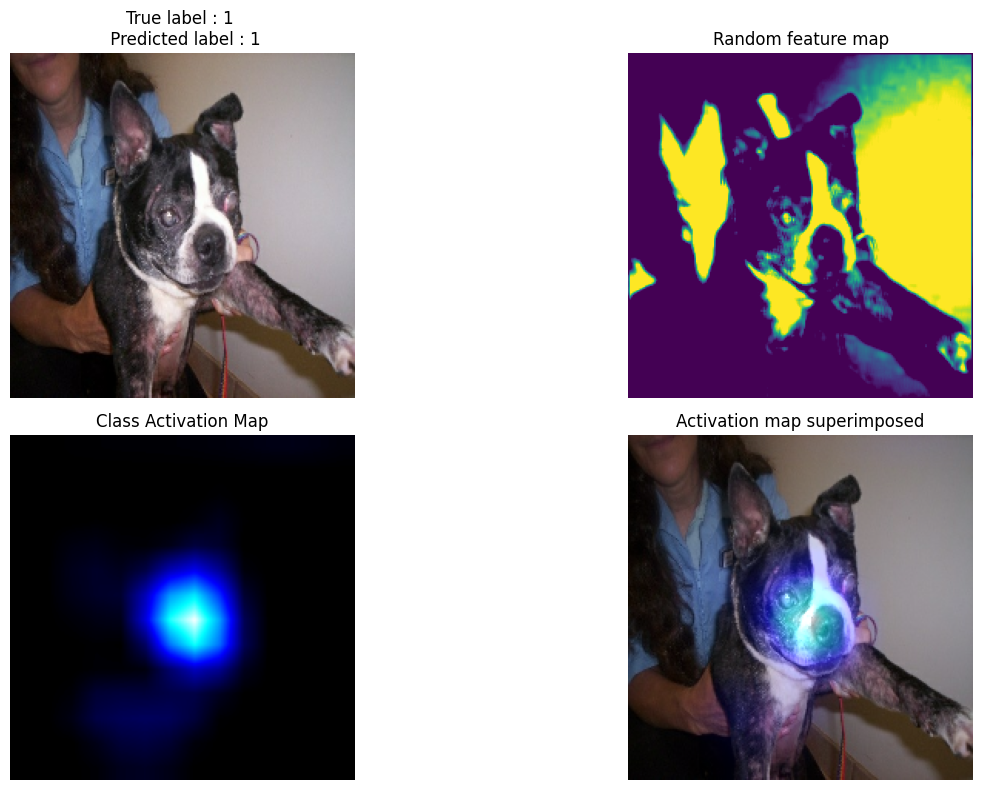

In [ ]:
# Choose an image index to show, or leave it as None to get a random image
activations = show_sample(idx = None)

# Intermediate activations of layers

In [ ]:
def visualize_intermediate_activations(layer_names, activations):
    assert len(layer_names)==len(activations), "Make sure layers and activation values match"
    images_per_row=16

    for layer_name, layer_activation in zip(layer_names, activations):
        # The number of feature maps in the activation.
        nb_features = layer_activation.shape[-1]
        # Size of each feature map
        size = layer_activation.shape[1]

        nb_cols = nb_features // images_per_row
        # np.zeros((rows,cols))
        grid = np.zeros((size*nb_cols, size*images_per_row))

        for col in range(nb_cols):
            for row in range(images_per_row):
                # For each position, feature_map is extracted from layer_activation.
                # Since layer_activation is a 4D array, the indexing [0, :, :, col * images_per_row + row]
                # extracts the feature map corresponding to the current position in the grid.
                feature_map = layer_activation[0,:,:,col*images_per_row + row]
                # Standardize the values and make the visualization more consistent across different feature maps.
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                # After normalization, the values are scaled to the range [0, 255] by multiplying by 255.
                # This prepares the values for visualization as pixel intensities.
                feature_map *=255
                # np.clip is used to ensure that all values are within the valid range of [0, 255].
                # Any values below 0 are set to 0, and any values above 255 are set to 255.
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                # The feature_map is then assigned to the corresponding position in the grid,
                # determined by the current col and row. The slicing grid[col * size:(col + 1) * size, row * size:(row + 1) * size]
                # selects the region of the grid where the current feature_map will be placed.
                grid[col*size:(col+1)*size, row*size:(row+1)*size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale*grid.shape[1], scale*grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(grid, aspect='auto', cmap='viridis')
    plt.show()

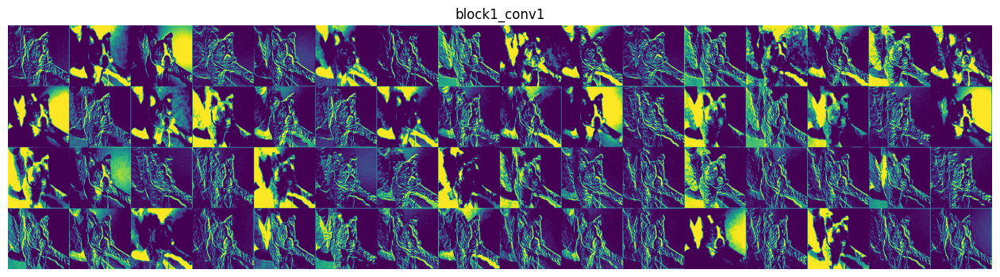

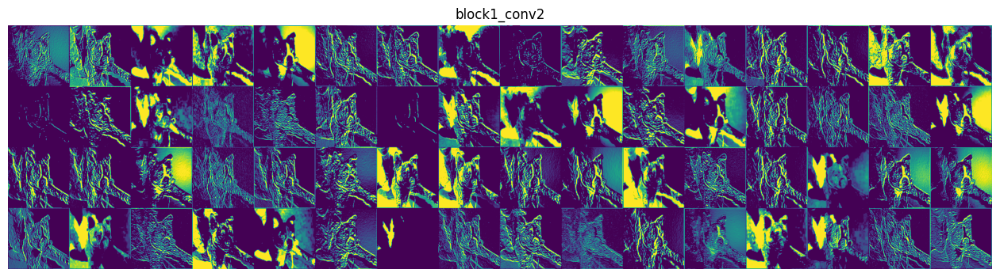

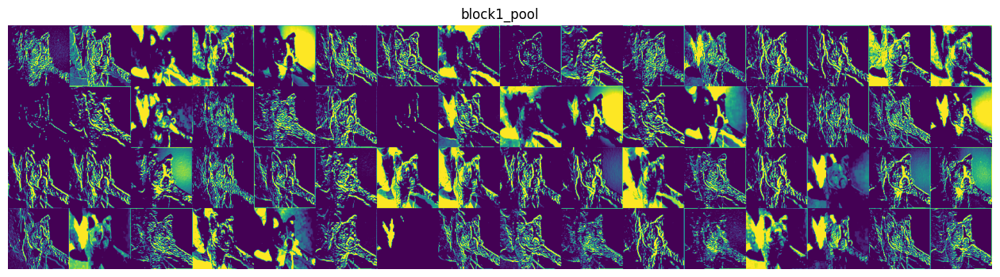

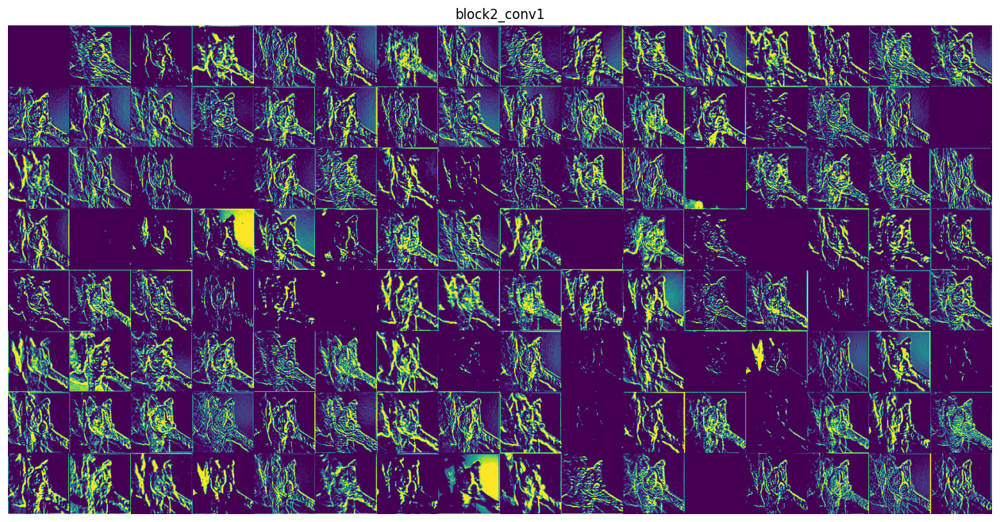

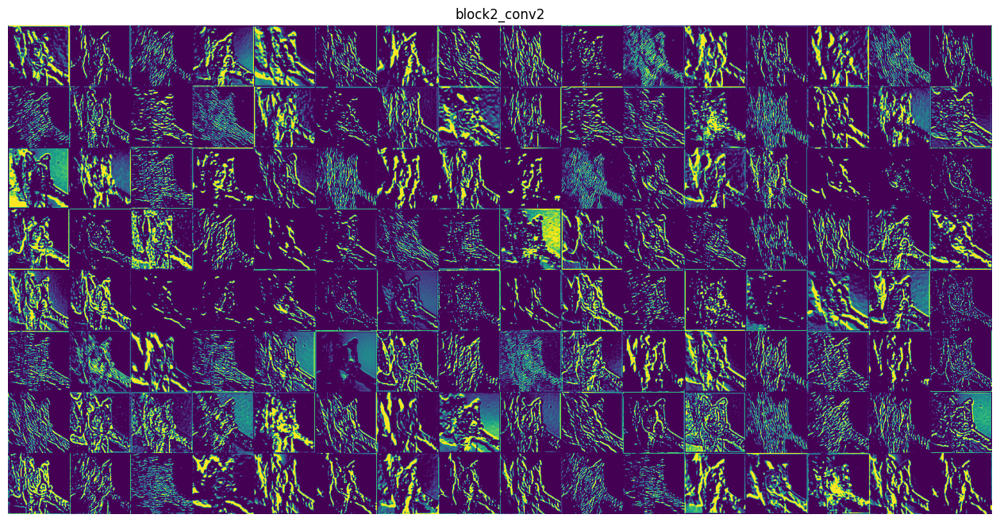

...

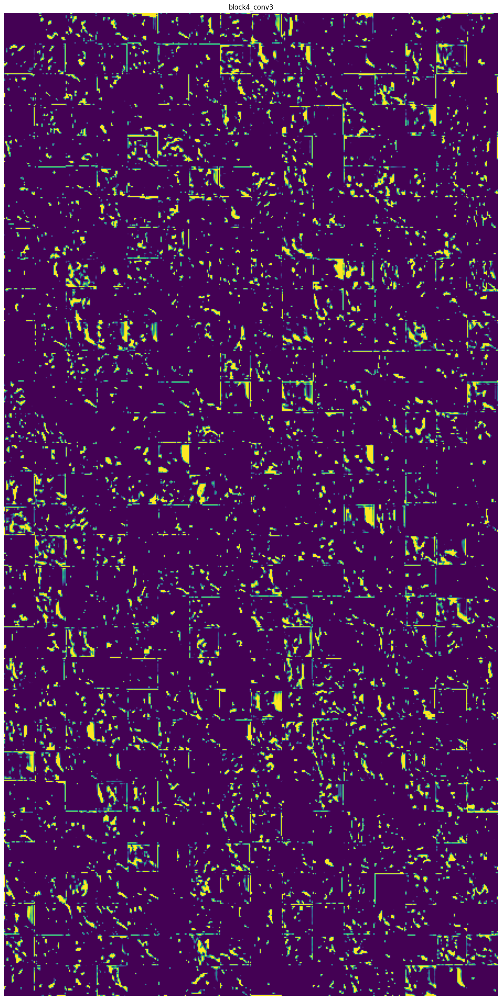

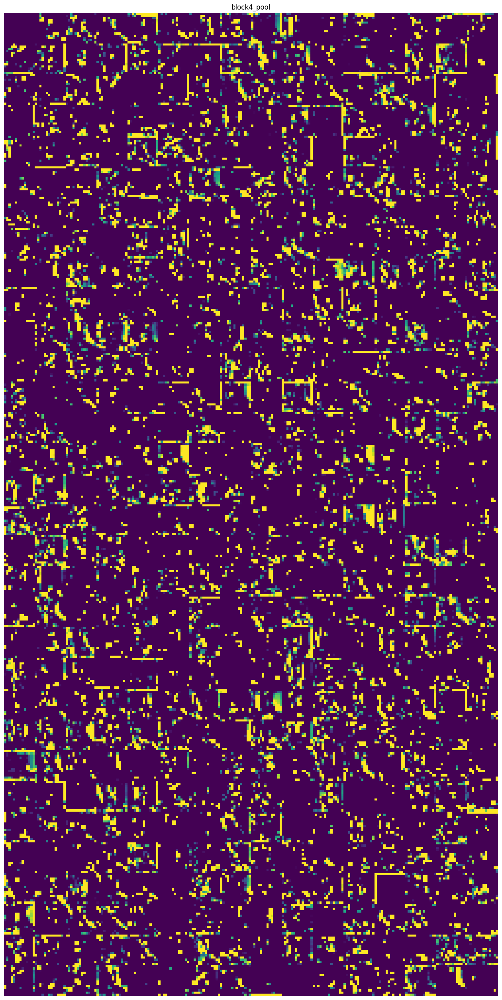

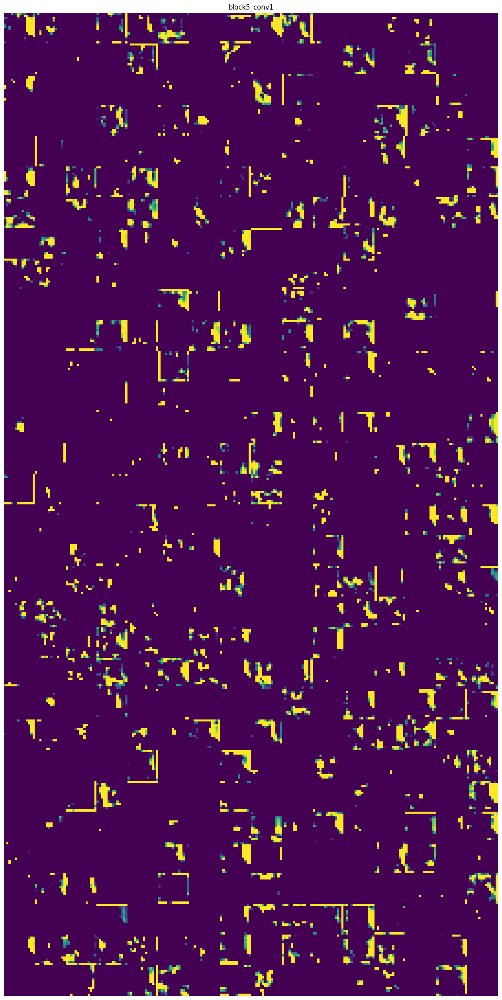

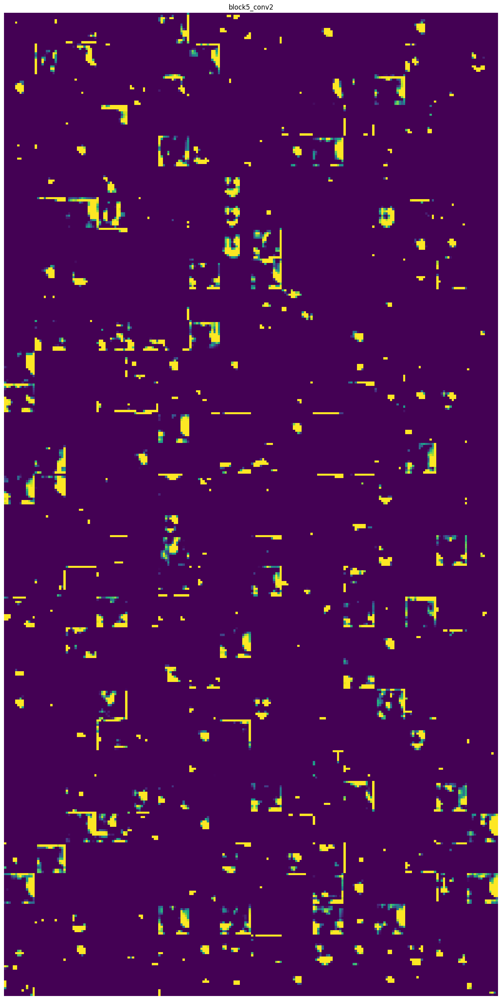

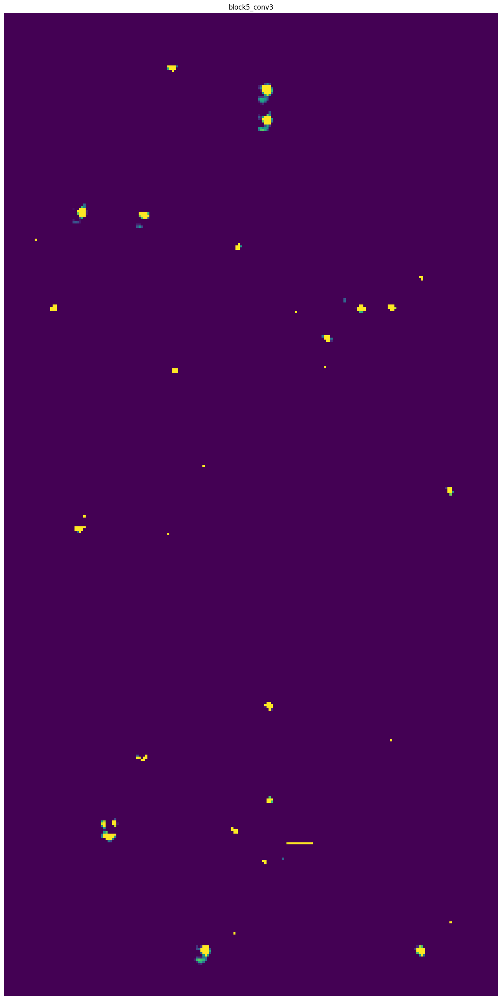

In [ ]:
visualize_intermediate_activations(activations = activations,
                                   layer_names = layer_names)